In [1]:
import os, sys
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa.display
import soundfile as sf
sys.path.append('..')
import libfmp.b

%matplotlib inline

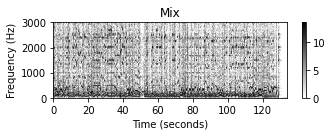

In [6]:
def compute_plot_spectrogram(x, Fs=22050, N=4096, H=2048, ylim=None,
                     figsize =(5, 2), title='', log=False):
    N, H = 1024, 512
    X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='hann', 
                     center=True, pad_mode='constant')
    Y = np.abs(X)**2
    if log:
        Y_plot = np.log(1 + 100 * Y)
    else:
        Y_plot = Y
    libfmp.b.plot_matrix(Y_plot, Fs=Fs/H, Fs_F=N/Fs, title=title, figsize=figsize)
    if ylim is not None:
        plt.ylim(ylim)
    plt.tight_layout()
    plt.show()
    return Y

Fs = 22050
# fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_Violin.wav')
# x, Fs = librosa.load(fn_wav, sr=Fs)
# Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Violin', ylim=[0, 3000], log=1)
# ipd.display(ipd.Audio(data=x, rate=Fs))

# fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_Castanets.wav')
# x, Fs = librosa.load(fn_wav, sr=Fs)
# Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Castanets', ylim=[0, 3000], log=1)
# ipd.display(ipd.Audio(data=x, rate=Fs))

fn_wav = os.path.join('data', 'blues-rock-instrumental-69-259289.mp3')
x, Fs = librosa.load(fn_wav, sr=Fs)
Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Mix', ylim=[0, 3000], log=1)
ipd.display(ipd.Audio(data=x, rate=Fs))

In [7]:
A = np.array([5.,3,2,8,2])
filter_len = 3
A_result = signal.medfilt(A, kernel_size=filter_len)
print('A        = ', A)
print('A_result = ', A_result)

A        =  [5. 3. 2. 8. 2.]
A_result =  [3. 3. 3. 2. 2.]


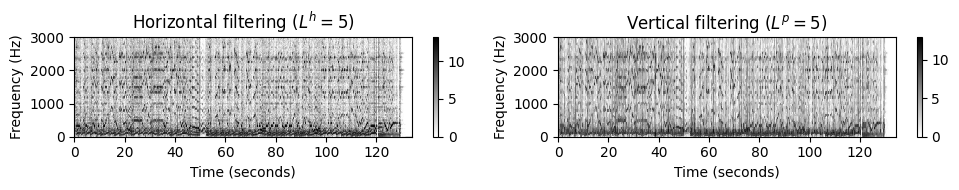

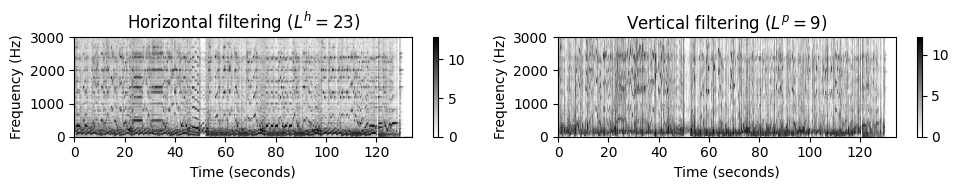

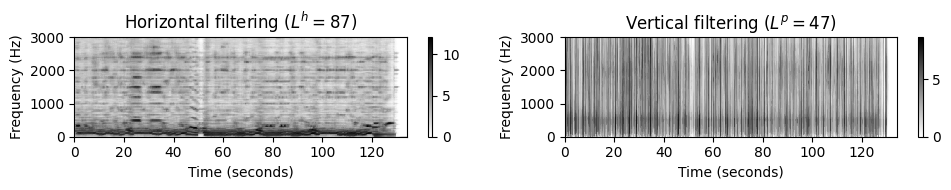

In [9]:
def median_filter_horizontal(x, filter_len):
    """Apply median filter in horizontal direction

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        x (np.ndarray): Input matrix
        filter_len (int): Filter length

    Returns:
        x_h (np.ndarray): Filtered matrix
    """
    return signal.medfilt(x, [1, filter_len])

def median_filter_vertical(x, filter_len):
    """Apply median filter in vertical direction

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        x: Input matrix
        filter_len (int): Filter length

    Returns:
        x_p (np.ndarray): Filtered matrix
    """
    return signal.medfilt(x, [filter_len, 1])

def plot_spectrogram_hp(Y_h, Y_p, Fs=22050, N=4096, H=2048, figsize =(10, 2), 
                         ylim=None, clim=None, title_h='', title_p='', log=False):
    if log: 
        Y_h_plot = np.log(1 + 100 * Y_h)
        Y_p_plot = np.log(1 + 100 * Y_p)
    else: 
        Y_h_plot = Y_h
        Y_p_plot = Y_p
    plt.figure(figsize=figsize)
    ax = plt.subplot(1,2,1)
    libfmp.b.plot_matrix(Y_h_plot, Fs=Fs/H, Fs_F=N/Fs, ax=[ax], clim=clim,
                         title=title_h, figsize=figsize)
    if ylim is not None:
        ax.set_ylim(ylim)
        
    ax = plt.subplot(1,2,2)
    libfmp.b.plot_matrix(Y_p_plot, Fs=Fs/H, Fs_F=N/Fs, ax=[ax], clim=clim,
                         title=title_p, figsize=figsize)
    if ylim is not None:
        ax.set_ylim(ylim)
  
    plt.tight_layout()
    plt.show()
    
Fs = 22050
fn_wav = os.path.join('data', 'blues-rock-instrumental-69-259289.mp3')
x, Fs = librosa.load(fn_wav, sr=Fs, mono=True)
N, H = 1024, 512
X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='hann', center=True, pad_mode='constant')
Y = np.abs(X)**2

L_set = np.array([[5,5],[23,9],[87,47]])
num = L_set.shape[0]
for m in range(num):
    L_h = L_set[m,0]
    L_p = L_set[m,1]
    Y_h = median_filter_horizontal(Y, L_h)
    Y_p = median_filter_vertical(Y, L_p)
    title_h = r'Horizontal filtering ($L^h=%d$)'%L_h
    title_p = r'Vertical filtering ($L^p=%d$)'%L_p
    plot_spectrogram_hp(Y_h, Y_p, Fs=Fs, N=N, H=H, 
            title_h=title_h, title_p=title_p, ylim=[0, 3000], log=True)

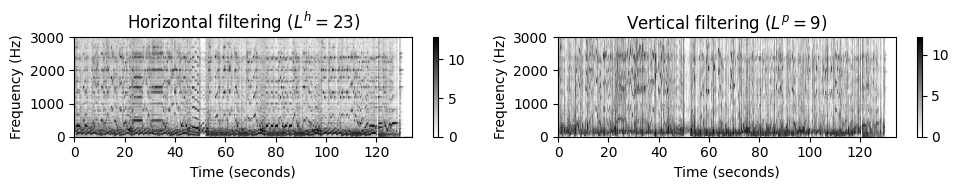

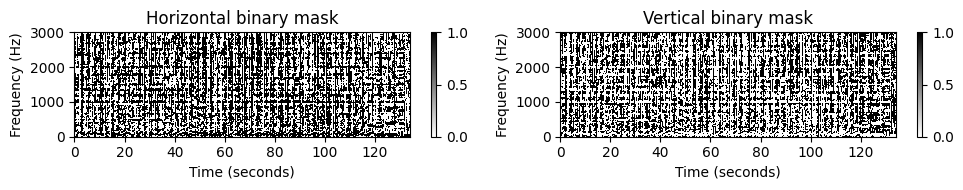

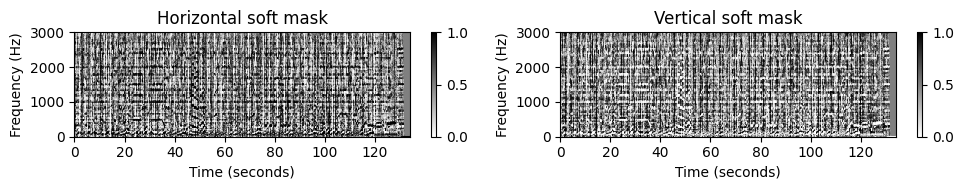

In [10]:
L_h = 23
L_p = 9
Y_h = median_filter_horizontal(Y, L_h)
Y_p = median_filter_vertical(Y, L_p)
title_h = r'Horizontal filtering ($L^h=%d$)'%L_h
title_p = r'Vertical filtering ($L^p=%d$)'%L_p
plot_spectrogram_hp(Y_h, Y_p, Fs=Fs, N=N, H=H, 
        title_h=title_h, title_p=title_p, ylim=[0, 3000], log=True)

M_binary_h = np.int8(Y_h >= Y_p)
M_binary_p = np.int8(Y_h < Y_p)
title_h = r'Horizontal binary mask'
title_p = r'Vertical binary mask'
plot_spectrogram_hp(M_binary_h, M_binary_p, Fs=Fs, N=N, H=H, clim=[0,1],
        title_h=title_h, title_p=title_p, ylim=[0, 3000])

eps = 0.00001
M_soft_h = (Y_h + eps/2)/(Y_h + Y_p + eps)
M_soft_p = (Y_p + eps/2)/(Y_h + Y_p + eps)
title_h = r'Horizontal soft mask'
title_p = r'Vertical soft mask'
plot_spectrogram_hp(M_soft_h, M_soft_p, Fs=Fs, N=N, H=H, clim=[0,1],
        title_h=title_h, title_p=title_p, ylim=[0, 3000])

In [12]:
X_h = X * M_binary_h
X_p = X * M_binary_p

x_h = librosa.istft(X_h, hop_length=H, win_length=N, window='hann', center=True, length=x.size)
x_p = librosa.istft(X_p, hop_length=H, win_length=N, window='hann', center=True, length=x.size)

print('Harmonic component signal')
ipd.display(ipd.Audio(data=x_h, rate=Fs))
print('Percussive component signal')
ipd.display(ipd.Audio(data=x_p, rate=Fs))

Harmonic component signal


Percussive component signal
